In [150]:
import torch
import numpy as np
import glob
import os
from torch_snippets import *
import glob
from IPython.display import clear_output
import pandas as pd
from PIL import Image
from sklearn.neighbors import NearestNeighbors
import cv2 as cv

In [151]:
images = glob.glob(os.getcwd() + '/data/oxford_buildings/oxbuild_images/*.jpg')
ground_truths = glob.glob(os.getcwd() + '/data/oxford_buildings/gt_files/*.txt')


In [284]:
label_types = ['_good.txt', '_junk.txt', '_ok.txt', '_query.txt']

def get_place_queries(gt_labels):
    places = []
    for gt_label in gt_labels:
        for label in label_types:
            if gt_label.endswith(label):
                x = gt_label.replace(label, " ")
                x = x.replace('C:\\Users\\olive\\OneDrive - University of Southampton\\Documents\\GitHub\\Visual-Place-Recognition/data/oxford_buildings/gt_files\\', ' ')
                places.append(x.strip())
                break
    return places

def get_place_query_results(places):
    all_places = {}
    for place in places:
        place_dict = {}
        fpath = 'C:\\Users\\olive\\OneDrive - University of Southampton\\Documents\\GitHub\\Visual-Place-Recognition/data/oxford_buildings/gt_files\\' +  place 
        for label_type in label_types:
            query_path = fpath + label_type
            query_images =pd.read_csv(query_path, header=None, delimiter=' ').to_numpy().squeeze()
            x = label_type.replace('_', ' ').replace('.txt', ' ').strip()
            place_dict[x] = query_images
        all_places[place] = place_dict
    return all_places
        
                
places = get_place_queries(ground_truths)
places_dict = get_place_query_results(places)


In [285]:
from tqdm import tqdm
from sklearn.cluster import MiniBatchKMeans

class generate_representations:
    def __init__(self, img_paths, places_dict, n_visual_words=100, n_neighbors=20):
        self.n_visual_words = n_visual_words
        self.img_paths = img_paths
        self.sift_detector = cv.SIFT_create()
        self.cluster = MiniBatchKMeans(n_clusters=n_visual_words)
        self.places_dict = places_dict
        self.neighbours = NearestNeighbors(n_neighbors=20)
        self.ds = False
    
    def compute_descriptors(self):
        for img_path in tqdm(self.img_paths):
            des = self.compute_features(img_path)
            try:
                self.ds = np.concatenate((self.ds, des))
            except: 
                self.ds = des
                
    
    def compute_bag_of_visual_words(self):
        diff = 1001
        i = 0
        n_batches = int(np.ceil(self.ds.shape[0]/diff))
        batch_n = 0
        while(i < self.ds.shape[0]):
            clear_output(wait=True)
            print((batch_n/n_batches)*100, "% done")
            batch = self.ds[i:i + diff]
            i = i+diff
            self.cluster.partial_fit(batch)
            batch_n += 1
            
        self.visual_words = self.cluster.cluster_centers_
        
    def compute_image_words(self):
        for img_path in tqdm(self.img_paths):
            if 'image_representations' in locals():
                row = np.concatenate((np.array([img_path]), self.infer(img_path)))
                image_representations = np.vstack((image_representations, row))
            else:
                image_representations = np.concatenate((np.array([img_path]), self.infer(img_path)))
        self.image_representations = image_representations
        self.neighbours.fit(image_representations[:, 1:].astype(int))
                
                
            
            
    def infer(self, img_path):
        des = self.compute_features(img_path)
        preds = self.cluster.predict(des)
        hist = np.bincount(preds, minlength=self.n_visual_words)
        return hist
    
            
    def compute_features(self, img_path):
        img = cv.imread(img_path)
        gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
        _, des = self.sift_detector.detectAndCompute(gray, None)
        return des
        
    
    def compute_top_list(self, place):
        place = self.places_dict[place]
        query_img = place["query"][0]
        query_img = query_img.replace('oxc1_', ' ').strip()
        query_path = 'C:\\Users\\olive\\OneDrive - University of Southampton\\Documents\\GitHub\\Visual-Place-Recognition/data/oxford_buildings/oxbuild_images\\' + query_img + '.jpg'
        rep = self.infer(query_path)
        dist, result = self.neighbours.kneighbors([rep])
        retrieved_images = self.image_representations[result[0], 0]
        return retrieved_images
        
        
        
    #def compute_ranked_list(self, place)
        
        
    

In [286]:
vpr = generate_representations(images[:50], places_dict=places_dict)
dataset = vpr.compute_descriptors()

100%|██████████████████████████████████████████████████████████████████████████████████| 50/50 [00:05<00:00,  8.58it/s]


In [287]:
vpr.compute_bag_of_visual_words()

99.42528735632183 % done

In [288]:
vpr.compute_image_words()

100%|██████████████████████████████████████████████████████████████████████████████████| 50/50 [00:06<00:00,  7.98it/s]


In [289]:
vpr.places_dict

{'all_souls_1': {'good': array(['all_souls_000091', 'all_souls_000026', 'oxford_003410',
         'oxford_002985', 'all_souls_000015', 'oxford_000926',
         'all_souls_000055', 'oxford_001955', 'all_souls_000140',
         'all_souls_000068', 'all_souls_000002', 'all_souls_000006',
         'all_souls_000209', 'all_souls_000146', 'oxford_001264',
         'all_souls_000013', 'oxford_000669', 'oxford_002503',
         'oxford_002338', 'oxford_000962', 'all_souls_000040',
         'all_souls_000150', 'oxford_001308', 'oxford_001806'], dtype=object),
  'junk': array(['all_souls_000220', 'all_souls_000019', 'all_souls_000017',
         'oxford_000135', 'all_souls_000062', 'oxford_000546',
         'all_souls_000145', 'all_souls_000000', 'all_souls_000188',
         'oxford_002762', 'all_souls_000202', 'all_souls_000059',
         'oxford_002508', 'all_souls_000176', 'all_souls_000053',
         'all_souls_000045', 'all_souls_000054', 'all_souls_000167',
         'all_souls_000085', 'al

In [290]:
retrieved_images = vpr.compute_top_list('all_souls_1')

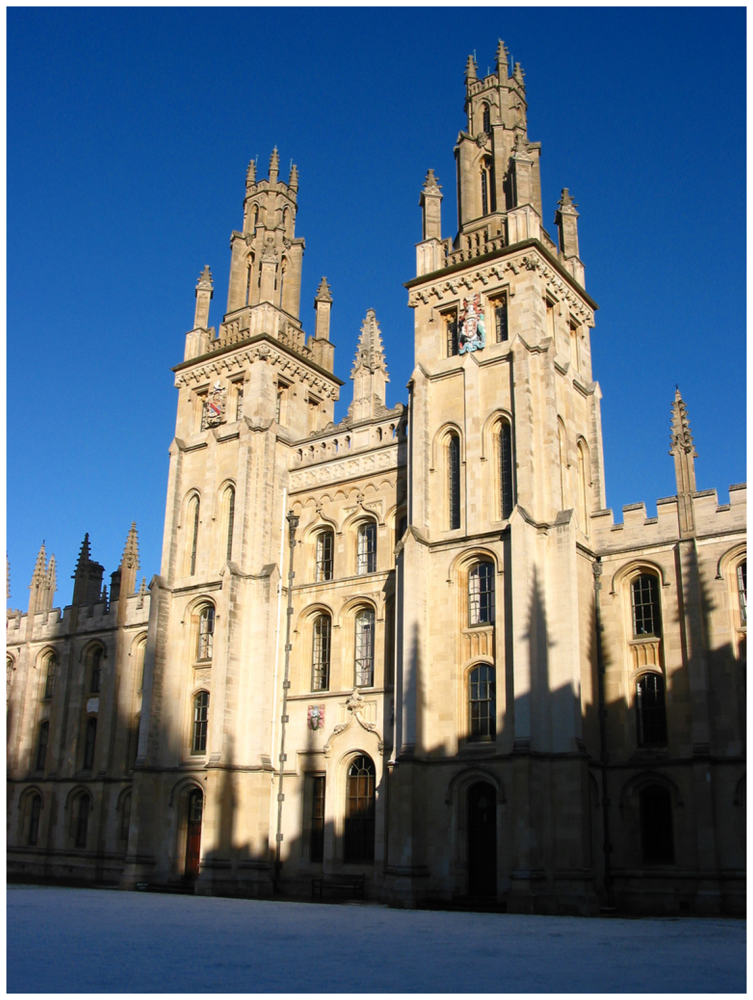

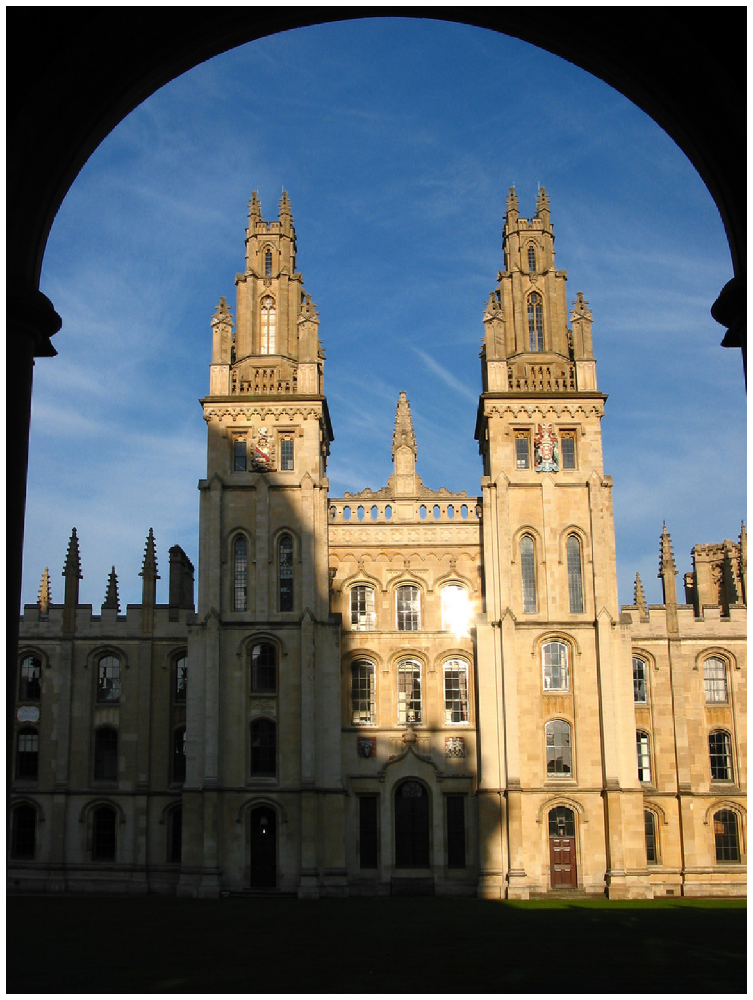

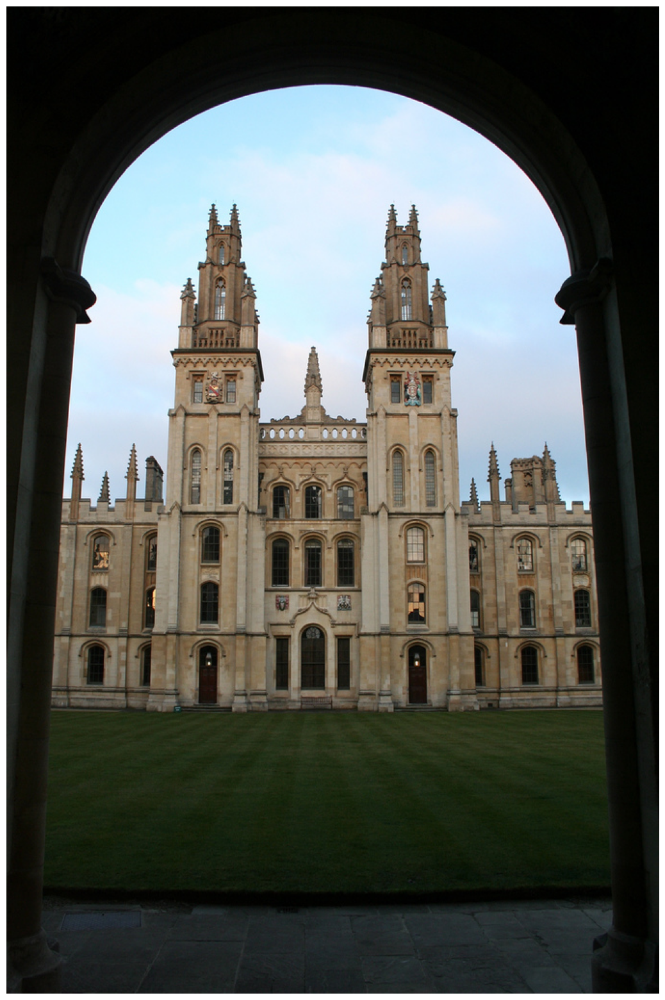

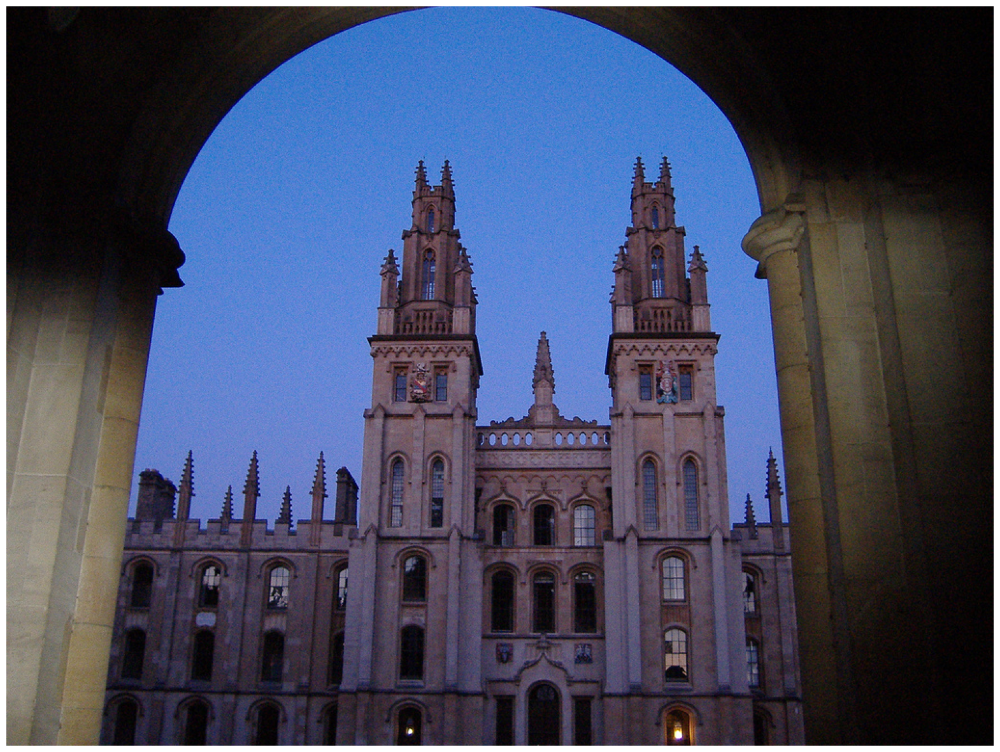

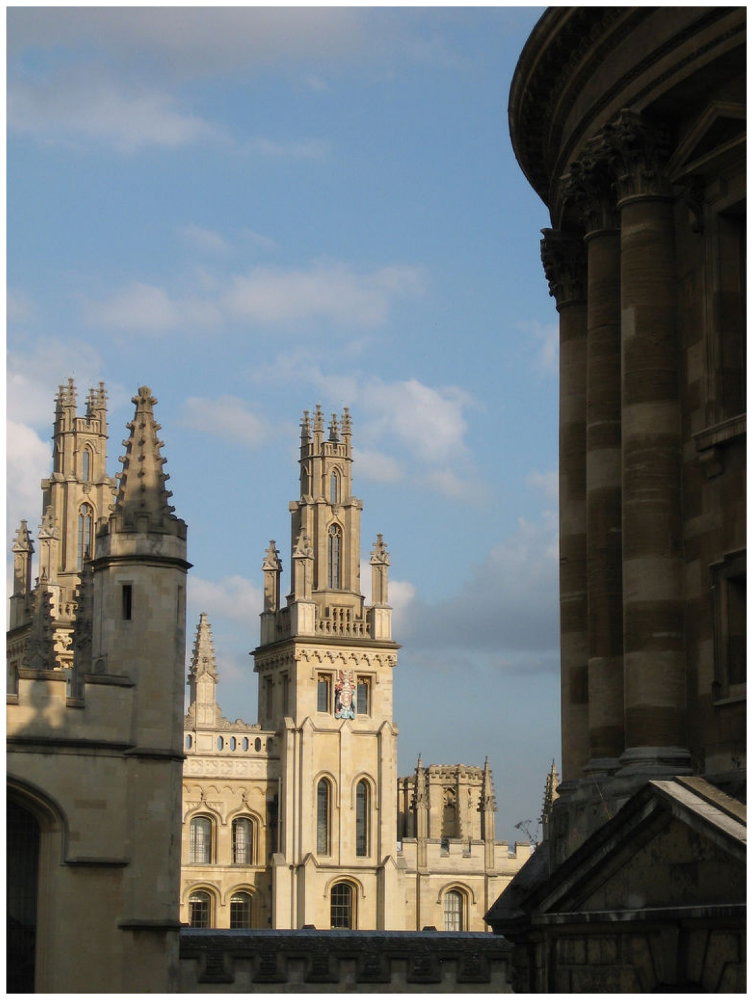

...

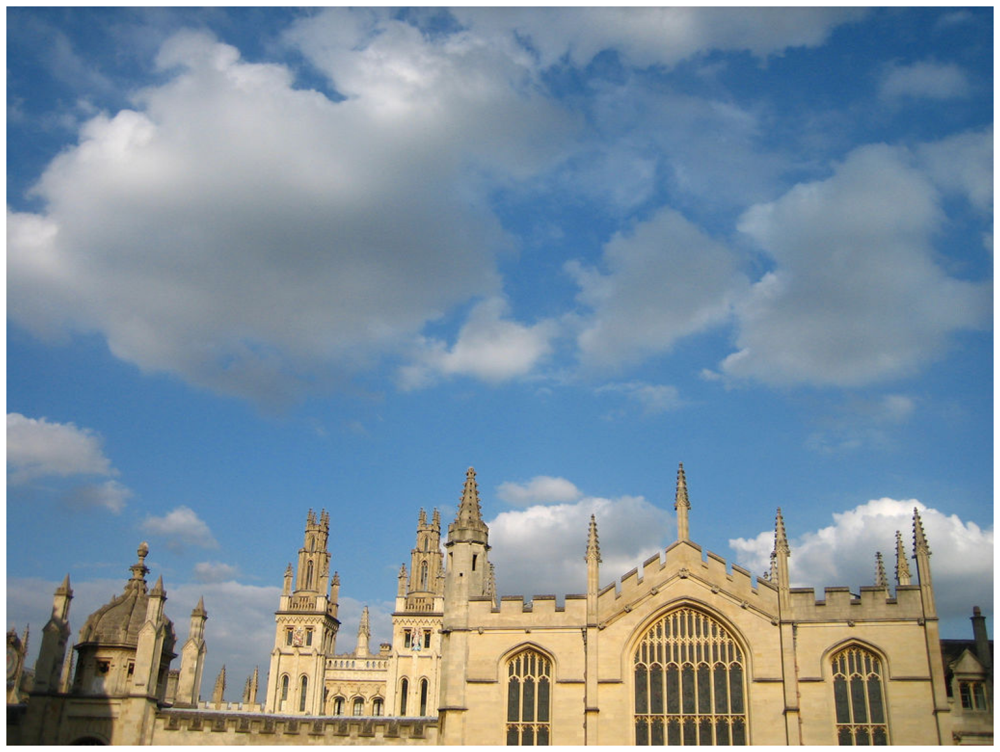

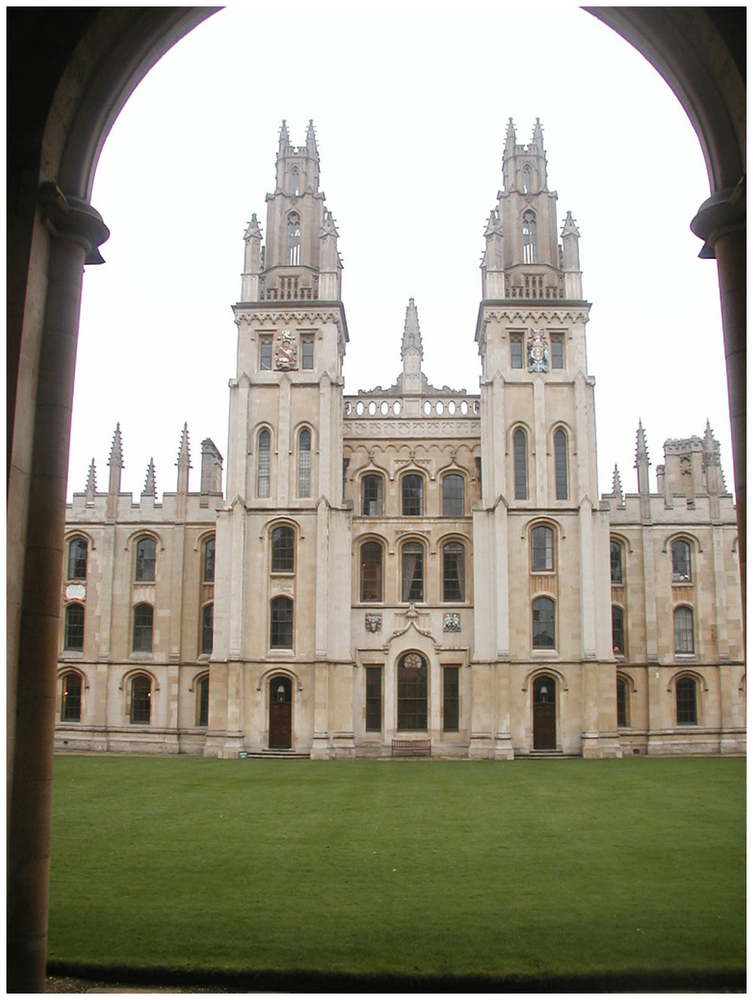

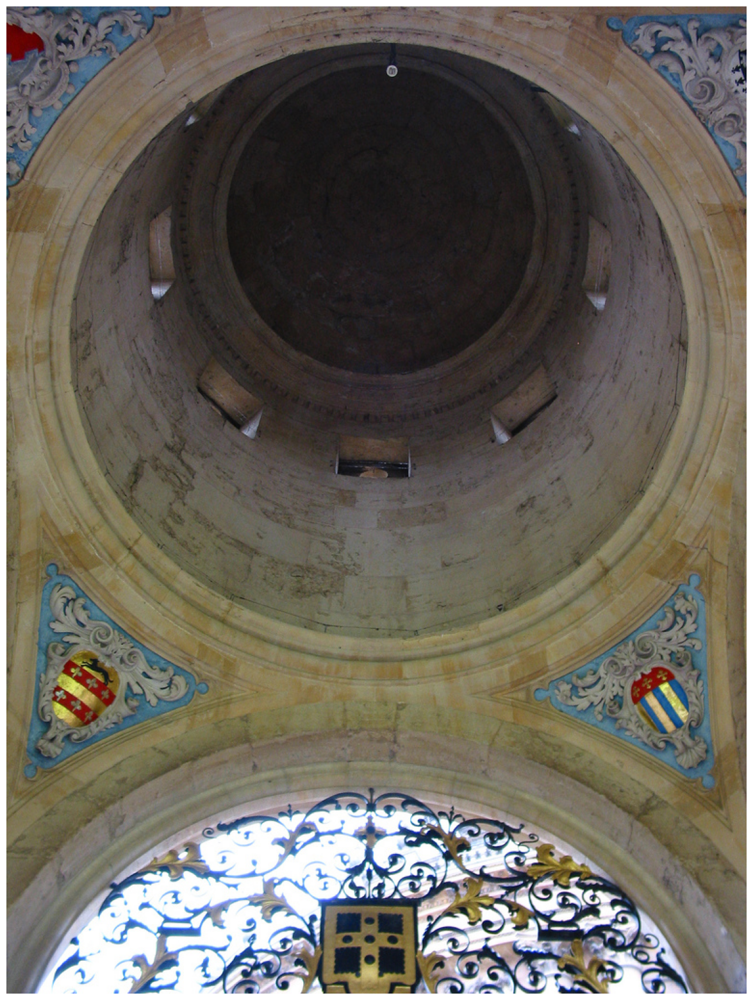

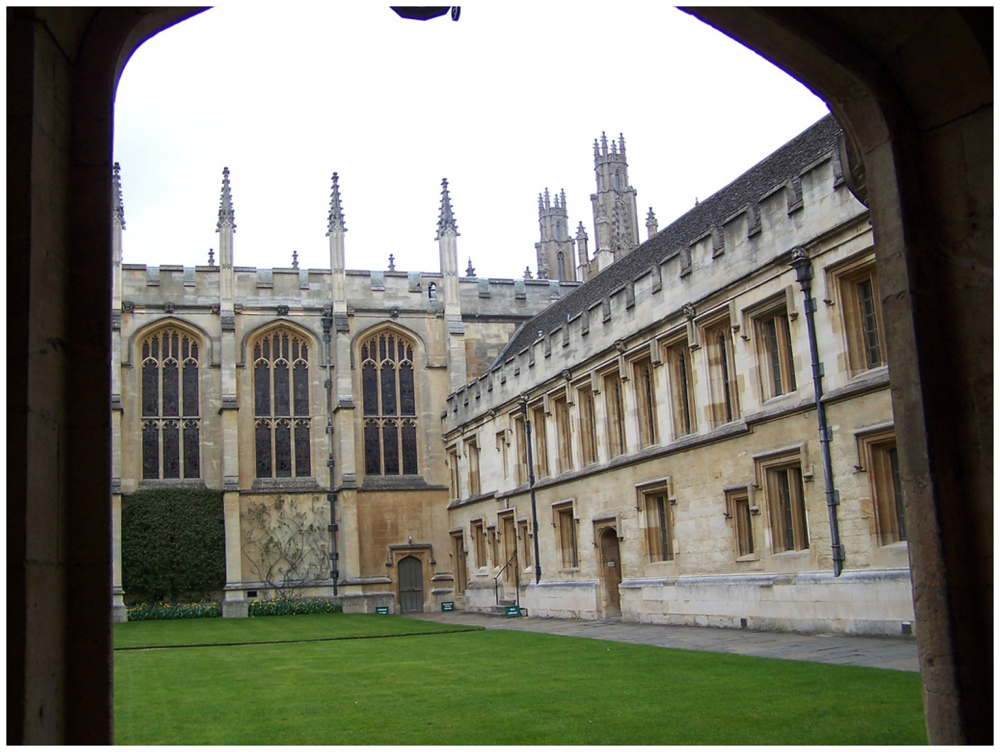

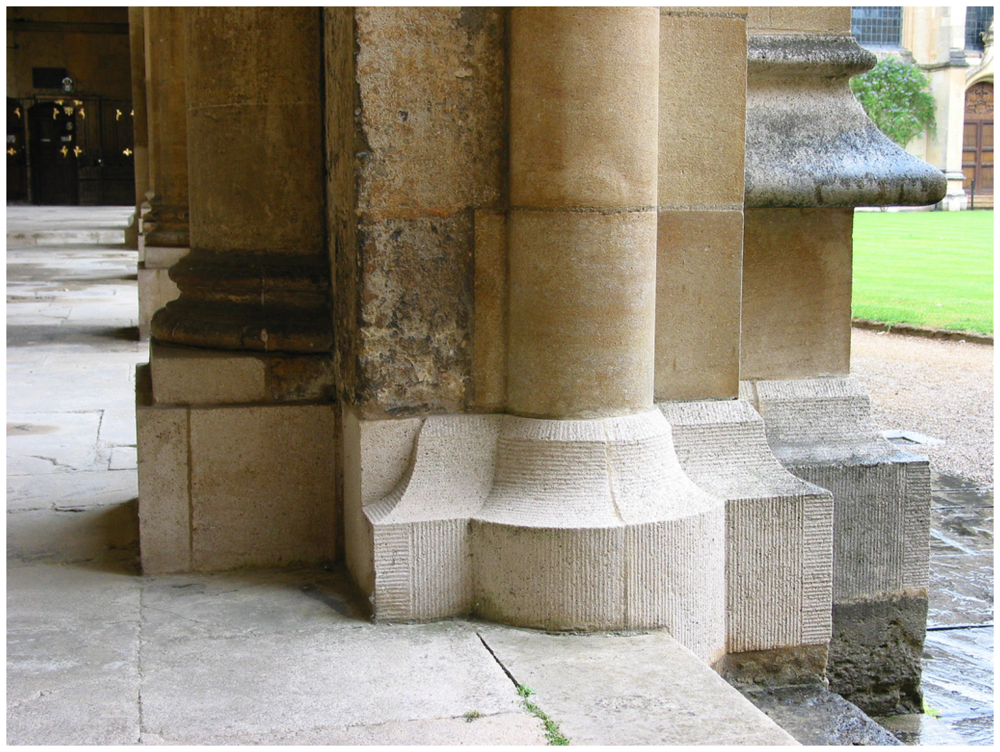

In [ ]:
for image in retrieved_images:
    im = Image.open(image, 'r')
    show(im)